In [1]:
import folium as fl
import pandas as pd
import matplotlib.pyplot as plt
import geopandas as gpd
from shapely.geometry import Point
import statsmodels.api as sm
import json
import numpy as np
from sklearn.preprocessing import StandardScaler
import seaborn as sns
import warnings

In [2]:
school_districts = 'data/school_districts.geojson'
housing_data = 'data/kc_house_data.csv'

In [3]:
data = pd.read_csv(housing_data)

In [4]:
data.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,greenbelt,...,sewer_system,sqft_above,sqft_basement,sqft_garage,sqft_patio,yr_built,yr_renovated,address,lat,long
0,7399300360,5/24/2022,675000.0,4,1.0,1180,7140,1.0,NO,NO,...,PUBLIC,1180,0,0,40,1969,0,"2102 Southeast 21st Court, Renton, Washington ...",47.461975,-122.19052
1,8910500230,12/13/2021,920000.0,5,2.5,2770,6703,1.0,NO,NO,...,PUBLIC,1570,1570,0,240,1950,0,"11231 Greenwood Avenue North, Seattle, Washing...",47.711525,-122.35591
2,1180000275,9/29/2021,311000.0,6,2.0,2880,6156,1.0,NO,NO,...,PUBLIC,1580,1580,0,0,1956,0,"8504 South 113th Street, Seattle, Washington 9...",47.502045,-122.22520
3,1604601802,12/14/2021,775000.0,3,3.0,2160,1400,2.0,NO,NO,...,PUBLIC,1090,1070,200,270,2010,0,"4079 Letitia Avenue South, Seattle, Washington...",47.566110,-122.29020
4,8562780790,8/24/2021,592500.0,2,2.0,1120,758,2.0,NO,NO,...,PUBLIC,1120,550,550,30,2012,0,"2193 Northwest Talus Drive, Issaquah, Washingt...",47.532470,-122.07188


In [5]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30155 entries, 0 to 30154
Data columns (total 25 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             30155 non-null  int64  
 1   date           30155 non-null  object 
 2   price          30155 non-null  float64
 3   bedrooms       30155 non-null  int64  
 4   bathrooms      30155 non-null  float64
 5   sqft_living    30155 non-null  int64  
 6   sqft_lot       30155 non-null  int64  
 7   floors         30155 non-null  float64
 8   waterfront     30155 non-null  object 
 9   greenbelt      30155 non-null  object 
 10  nuisance       30155 non-null  object 
 11  view           30155 non-null  object 
 12  condition      30155 non-null  object 
 13  grade          30155 non-null  object 
 14  heat_source    30123 non-null  object 
 15  sewer_system   30141 non-null  object 
 16  sqft_above     30155 non-null  int64  
 17  sqft_basement  30155 non-null  int64  
 18  sqft_g

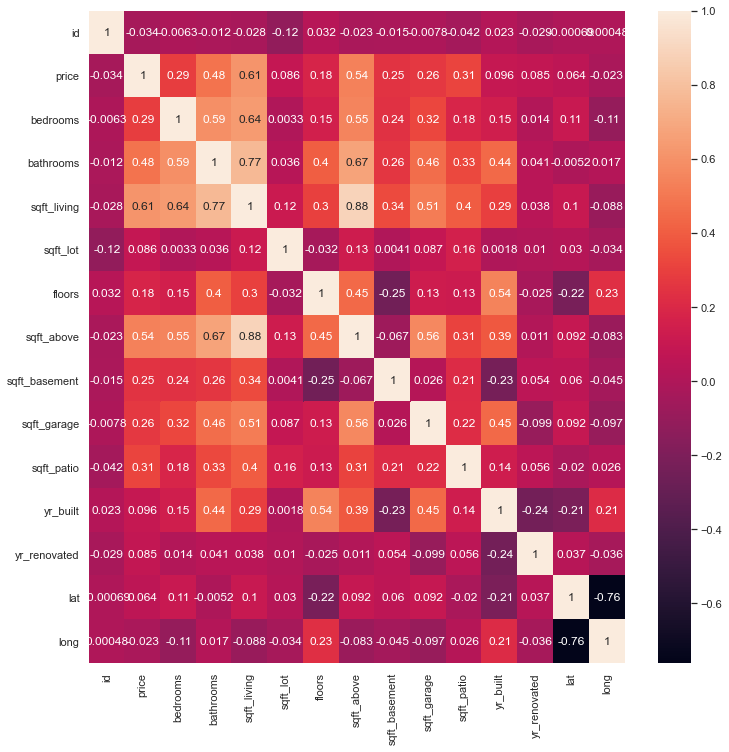

In [6]:
sns.set(rc={'figure.figsize': (12,12)})
sns.heatmap(data.corr(), annot=True);

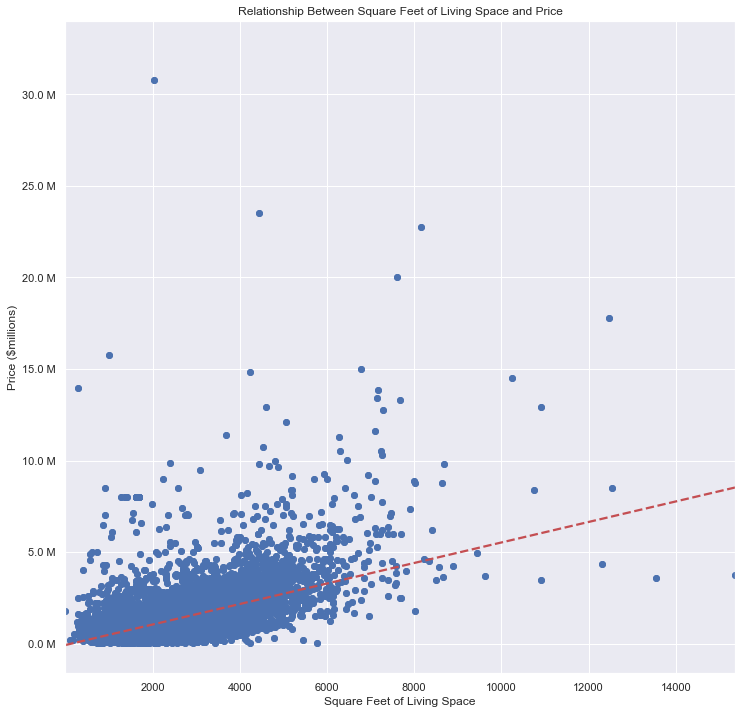

In [7]:
# create plot of square feet of living space vs price
fig, ax = plt.subplots()

plt.scatter(x=data["sqft_living"], y=data["price"])
sns.regplot(data = data, x = 'sqft_living', y = 'price', line_kws={'ls':'--', 'color': 'r'}, ci = None)
ax.set_xlabel('Square Feet of Living Space')
ax.set_ylabel('Price ($millions)')
ax.set_title('Relationship Between Square Feet of Living Space and Price')

# format y axis to show values in millions
def million_formatter(x, pos):
    '''
    Takes two inputs (a tick value ``x`` and a position ``pos``), and returns a 
    string containing the corresponding tick label and the value divided by
    1,000,000 with an M at the end to indicate a value in millions
    '''
    return "%.1f M" % (x/1E6)

ax.set_yticks(range(-1000000, 35000000, 1000000), minor = True)
ax.yaxis.set_major_formatter(million_formatter);


In [8]:
data['lat'].min(), data['lat'].max()

(21.27424, 64.82406999999999)

In [9]:
data['long'].min(), data['long'].max()

(-157.79148, -70.07434)

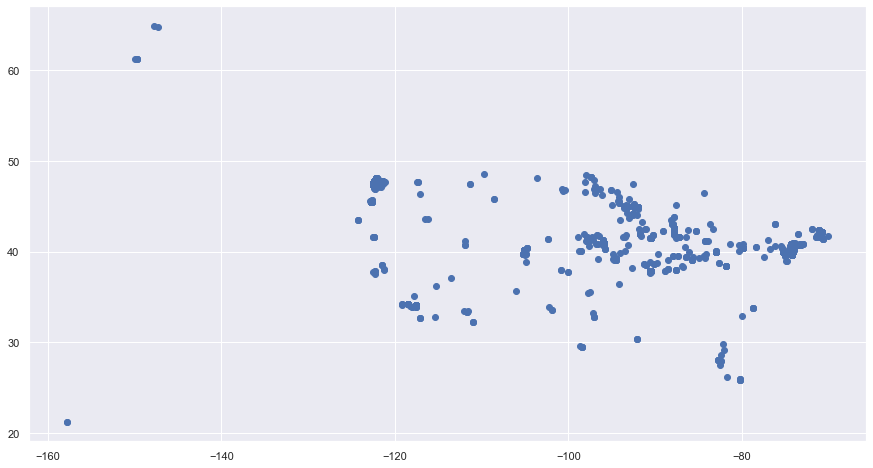

In [10]:
fig, ax = plt.subplots(figsize=[15,8])
ax.scatter(data['long'], data['lat']);

In [11]:
data = data.loc[(data['long'] > -140) & (data['long'] < -121.6) & (data['lat'] > 47.1) & (data['lat'] < 47.8)]

In [12]:
to_drop = data.loc[((data['long'] < -121.9) & (data['lat'] > 47.78)) |
                   ((data['long'] < -122.2) & (data['lat'] < 47.2)) |
                   ((data['long'] > -121.8) & (data['lat'] < 47.2))
                  ]

In [13]:
data = data.drop(index=to_drop.index)

In [14]:
data['price'].describe()

count    2.918600e+04
mean     1.113178e+06
std      8.956970e+05
min      2.736000e+04
25%      6.450000e+05
50%      8.680000e+05
75%      1.310000e+06
max      3.075000e+07
Name: price, dtype: float64

In [15]:
bottom_025 = sorted(data['price'])[int(len(data)*0.025)]
top_975 = sorted(data['price'])[int(len(data)*0.975)]

In [16]:
data = data.loc[(data['price'] > bottom_025) & (data['price'] < top_975)]

### For our analysis, we're only interested in the zipcode of the location, so we'll drop all address other info

In [17]:
data['zipcode'] = data.address.str.split(',', expand = True)[2].str.strip().str.split(' ', expand = True)[1]
# Because of some oddly formatted addresses, we need to manually assign the zipcode for four rows:
warnings.filterwarnings('ignore')
data['zipcode'].loc[(data['id'] == 139000091) | (data['id'] == 139000123) | (data['id'] == 139000125)] = 98126
data['zipcode'].loc[data['id'] == 4083306403] = 98103
data.drop(['address'], axis=1, inplace=True)
data['zipcode'] = data['zipcode'].astype(int)

In [18]:
data['date'] = pd.DatetimeIndex(data['date']).year
data['age'] = data['date'] - data['yr_built']
data = data.drop(columns=['yr_built'])

In [19]:
# data = data.dropna()

In [20]:
data.to_csv("data/kc_house_data_clean.csv")

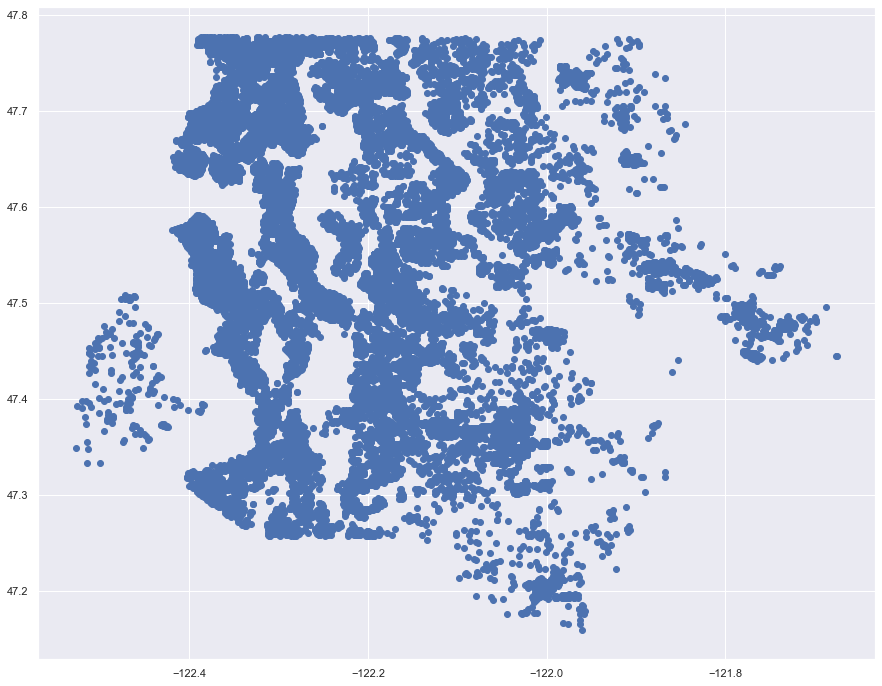

In [21]:
fig, ax = plt.subplots(figsize=[15,12])

ax.scatter(data['long'], data['lat']);

In [22]:
def plotPoint(df):
    fl.CircleMarker(location=[df['lat'], df['long']], radius=0.1, color='red').add_to(m)

In [23]:
m = fl.Map(location=[47.51, -122.0],
           zoom_start=10,
           control_scale=True,
           tiles='Stamen Terrain',
           attr="http://stamen.com")
fl.GeoJson(school_districts, tooltip=fl.GeoJsonTooltip(fields=['NAME'])).add_to(m)
data.apply(plotPoint, axis=1)
m.save("district_map.html")
m

In [24]:
district_regions = json.load(open(school_districts))

In [25]:
district_nums = {}
for i in district_regions['features']:
    district_nums[float(i['properties']['OBJECTID']-1)] = i['properties']['NAME']

In [26]:
district_regions = gpd.GeoDataFrame.from_file('data/school_districts.shp')

In [27]:
houses = pd.DataFrame()

In [28]:
data['coords'] = list(zip(data['long'], data['lat']))
data['coords'] = data['coords'].apply(Point)

In [29]:
houses = gpd.GeoDataFrame(data['coords'], geometry='coords', crs=district_regions.crs)

In [30]:
house_in_districts = gpd.tools.sjoin(houses, district_regions, predicate="within", how='left')

In [31]:
house_in_districts = pd.DataFrame(house_in_districts)

In [32]:
data = data.join(house_in_districts, lsuffix='_left', rsuffix='_right')

In [33]:
data = data.dropna()

In [34]:
data = data.drop(columns=['coords_left', 'coords_right'])

In [35]:
data = data.rename(columns={'index_right':'district'})

In [36]:
data = data.replace({"district": district_nums})

In [37]:
data.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,greenbelt,...,sqft_above,sqft_basement,sqft_garage,sqft_patio,yr_renovated,lat,long,zipcode,age,district
0,7399300360,2022,675000.0,4,1.0,1180,7140,1.0,NO,NO,...,1180,0,0,40,0,47.461975,-122.190520,98055,53,Renton
1,8910500230,2021,920000.0,5,2.5,2770,6703,1.0,NO,NO,...,1570,1570,0,240,0,47.711525,-122.355910,98133,71,Seattle
3,1604601802,2021,775000.0,3,3.0,2160,1400,2.0,NO,NO,...,1090,1070,200,270,0,47.566110,-122.290200,98118,11,Seattle
4,8562780790,2021,592500.0,2,2.0,1120,758,2.0,NO,NO,...,1120,550,550,30,0,47.532470,-122.071880,98027,9,Issaquah
5,2807100156,2021,625000.0,2,1.0,1190,5688,1.0,NO,NO,...,1190,0,300,0,0,47.763470,-122.340155,98133,73,Shoreline


In [38]:
data.to_csv('data/kc_house_data_districts.csv')

In [39]:
# model_data = data.drop(columns = ['lat', 'long', 'id', 'floors', 'sqft_basement', 'date'])
model_data = data.drop(columns=['floors', 'sqft_basement', 'greenbelt', 'lat', 'long', 'id', 'age'])

### Log of price makes for much better normal distribution

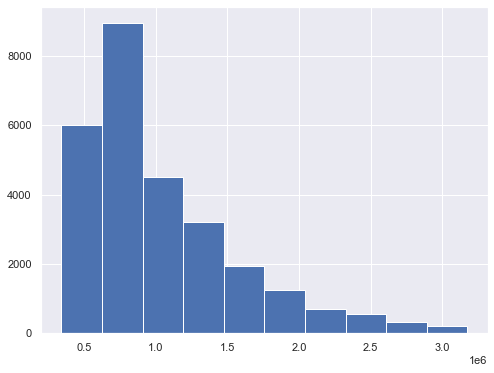

In [40]:
sns.set(rc={'figure.figsize': (8,6)})
model_data['price'].hist();

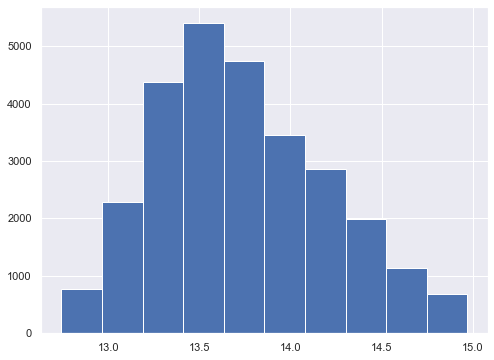

In [41]:
np.log(model_data['price']).hist();

In [42]:
y = np.log(model_data['price'])

## Dummie out district column 
### $R^2_{adj}$: 0.644

In [43]:
model_data = model_data.join(pd.get_dummies(data['district'])).drop(columns=['district', 'Enumclaw'])

In [44]:
X = sm.add_constant(model_data.drop(columns=['price', 'waterfront', 'nuisance', 'view', 'condition', 'grade', 'heat_source', 'sewer_system']))
model = sm.OLS(y, X)
model.fit().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.719
Model:                            OLS   Adj. R-squared:                  0.719
Method:                 Least Squares   F-statistic:                     2528.
Date:                Fri, 31 Mar 2023   Prob (F-statistic):               0.00
Time:                        12:15:19   Log-Likelihood:                -761.00
No. Observations:               27698   AIC:                             1580.
Df Residuals:                   27669   BIC:                             1819.
Df Model:                          28                                         
Covariance Type:            nonrobust                                         
=====================================================================================
                        coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------
const              -266.2205      8.428    -31.588      0.000    -282.740    -249.701
date                  0.1354      0.003     43.346      0.000       0.129       0.142
bedrooms             -0.0130      0.002     -6.152      0.000      -0.017      -0.009
bathrooms             0.0339      0.003     11.994      0.000       0.028       0.039
sqft_living           0.0002   4.39e-06     50.035      0.000       0.000       0.000
sqft_lot           4.881e-07    2.7e-08     18.050      0.000    4.35e-07    5.41e-07
sqft_above         8.067e-05   4.03e-06     20.013      0.000    7.28e-05    8.86e-05
sqft_garage        5.712e-05   7.18e-06      7.960      0.000    4.31e-05    7.12e-05
sqft_patio         8.594e-05   6.99e-06     12.298      0.000    7.22e-05    9.96e-05
yr_renovated       4.072e-05   3.67e-06     11.082      0.000    3.35e-05    4.79e-05
zipcode            5.269e-05   5.72e-05      0.921      0.357   -5.95e-05       0.000
Auburn               -0.0256      0.012     -2.072      0.038      -0.050      -0.001
Bellevue              0.8436      0.012     69.861      0.000       0.820       0.867
Federal Way          -0.0059      0.011     -0.523      0.601      -0.028       0.016
Fife                 -0.0252      0.027     -0.935      0.350      -0.078       0.028
Highline              0.1474      0.014     10.184      0.000       0.119       0.176
Issaquah              0.5782      0.012     49.859      0.000       0.555       0.601
Kent                  0.0590      0.011      5.390      0.000       0.038       0.081
Lake Washington       0.7280      0.011     66.404      0.000       0.707       0.750
Mercer Island         0.9315      0.018     51.195      0.000       0.896       0.967
Northshore            0.5151      0.012     42.638      0.000       0.491       0.539
Renton                0.2341      0.012     19.630      0.000       0.211       0.257
Riverview             0.3083      0.015     20.443      0.000       0.279       0.338
Seattle               0.5540      0.012     46.907      0.000       0.531       0.577
Shoreline             0.4210      0.015     28.805      0.000       0.392       0.450
Snoqualmie Valley     0.3727      0.013     29.345      0.000       0.348       0.398
Tahoma                0.1545      0.012     12.401      0.000       0.130       0.179
Tukwila               0.0945      0.025      3.761      0.000       0.045       0.144
Vashon Island         0.3749      0.021     17.680      0.000       0.333       0.417
==============================================================================
Omnibus:                     1942.355   Durbin-Watson:                   1.976
Prob(Omnibus):                  0.000   Jarque-Bera (JB):            10250.921
Skew:                          -0.008   Prob(JB):                         0.00
Kurtosis:      

## Dummie out additional object columns

### Dummie heat source

In [45]:
model_data = model_data.join(pd.get_dummies(model_data['heat_source'], prefix='heat')).drop(columns=['heat_source', 'heat_Gas'])

In [46]:
X = model_data.drop(columns=['price', 'waterfront','nuisance', 'view', 'condition', 'grade', 'sewer_system'])
model = sm.OLS(y, sm.add_constant(X))
model.fit().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.721
Model:                            OLS   Adj. R-squared:                  0.721
Method:                 Least Squares   F-statistic:                     2104.
Date:                Fri, 31 Mar 2023   Prob (F-statistic):               0.00
Time:                        12:15:19   Log-Likelihood:                -654.31
No. Observations:               27698   AIC:                             1379.
Df Residuals:                   27663   BIC:                             1667.
Df Model:                          34                                         
Covariance Type:            nonrobust                                         
==========================================================================================
                             coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                   -266.0734      8.402    -31.668      0.000    -282.542    -249.605
date                       0.1354      0.003     43.481      0.000       0.129       0.141
bedrooms                  -0.0140      0.002     -6.620      0.000      -0.018      -0.010
bathrooms                  0.0351      0.003     12.165      0.000       0.029       0.041
sqft_living                0.0002    4.4e-06     49.005      0.000       0.000       0.000
sqft_lot                5.218e-07   2.72e-08     19.220      0.000    4.69e-07    5.75e-07
sqft_above              7.907e-05   4.02e-06     19.656      0.000    7.12e-05    8.69e-05
sqft_garage             4.898e-05   7.18e-06      6.818      0.000    3.49e-05    6.31e-05
sqft_patio              9.516e-05      7e-06     13.600      0.000    8.14e-05       0.000
yr_renovated            4.127e-05   3.66e-06     11.263      0.000    3.41e-05    4.84e-05
zipcode                 5.258e-05    5.7e-05      0.922      0.357   -5.92e-05       0.000
Auburn                    -0.0221      0.012     -1.796      0.072      -0.046       0.002
Bellevue                   0.8373      0.012     69.515      0.000       0.814       0.861
Federal Way               -0.0086      0.011     -0.766      0.444      -0.031       0.013
Fife                      -0.0173      0.027     -0.644      0.520      -0.070       0.035
Highline                   0.1513      0.014     10.482      0.000       0.123       0.180
Issaquah                   0.5778      0.012     50.001      0.000       0.555       0.600
Kent                       0.0590      0.011      5.404      0.000       0.038       0.080
Lake Washington            0.7258      0.011     66.421      0.000       0.704       0.747
Mercer Island              0.9276      0.018     51.140      0.000       0.892       0.963
Northshore                 0.5161      0.012     42.868      0.000       0.493       0.540
Renton                     0.2326      0.012     19.566      0.000       0.209       0.256
Riverview                  0.3116      0.015     20.733      0.000       0.282       0.341
Seattle                    0.5562      0.012     47.215      0.000       0.533       0.579
Shoreline                  0.4253      0.015     29.167      0.000       0.397       0.454
Snoqualmie Valley          0.3751      0.013     29.640      0.000       0.350       0.400
Tahoma                     0.1558      0.012     12.546      0.000       0.131       0.180
Tukwila                    0.0961      0.025      3.837      0.000       0.047       0.145
Vashon Island              0.3883      0.021     18.338      0.000       0.347       0.430
heat_Electricity          -0.0548      0.004    -13.745      0.000      -0.063      -0.047
heat_Electricity/Solar    -0.0429      0.037     -1.159      0.246      -0.116  

### Dummie waterfront

In [47]:
model_data['waterfront'] = pd.get_dummies(model_data['waterfront'], drop_first=True).rename(columns={'YES': 'waterfront'})

In [48]:
X = model_data.drop(columns=['price', 'nuisance', 'view', 'condition', 'grade', 'sewer_system'])
model = sm.OLS(y, sm.add_constant(X))
model.fit().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.726
Model:                            OLS   Adj. R-squared:                  0.726
Method:                 Least Squares   F-statistic:                     2095.
Date:                Fri, 31 Mar 2023   Prob (F-statistic):               0.00
Time:                        12:15:19   Log-Likelihood:                -408.64
No. Observations:               27698   AIC:                             889.3
Df Residuals:                   27662   BIC:                             1186.
Df Model:                          35                                         
Covariance Type:            nonrobust                                         
==========================================================================================
                             coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                   -266.4939      8.328    -32.000      0.000    -282.817    -250.171
date                       0.1362      0.003     44.149      0.000       0.130       0.142
bedrooms                  -0.0106      0.002     -5.076      0.000      -0.015      -0.007
bathrooms                  0.0348      0.003     12.182      0.000       0.029       0.040
sqft_living                0.0002   4.36e-06     48.382      0.000       0.000       0.000
sqft_lot                5.006e-07   2.69e-08     18.590      0.000    4.48e-07    5.53e-07
waterfront                 0.3016      0.014     22.251      0.000       0.275       0.328
sqft_above              8.052e-05   3.99e-06     20.194      0.000    7.27e-05    8.83e-05
sqft_garage             5.958e-05   7.14e-06      8.349      0.000    4.56e-05    7.36e-05
sqft_patio              8.491e-05   6.95e-06     12.216      0.000    7.13e-05    9.85e-05
yr_renovated            3.574e-05   3.64e-06      9.818      0.000    2.86e-05    4.29e-05
zipcode                 3.861e-05   5.65e-05      0.683      0.495   -7.22e-05       0.000
Auburn                    -0.0244      0.012     -1.997      0.046      -0.048      -0.000
Bellevue                   0.8382      0.012     70.204      0.000       0.815       0.862
Federal Way               -0.0168      0.011     -1.502      0.133      -0.039       0.005
Fife                      -0.0196      0.027     -0.736      0.462      -0.072       0.033
Highline                   0.1515      0.014     10.589      0.000       0.123       0.180
Issaquah                   0.5766      0.011     50.336      0.000       0.554       0.599
Kent                       0.0551      0.011      5.088      0.000       0.034       0.076
Lake Washington            0.7264      0.011     67.069      0.000       0.705       0.748
Mercer Island              0.9278      0.018     51.605      0.000       0.893       0.963
Northshore                 0.5161      0.012     43.248      0.000       0.493       0.539
Renton                     0.2320      0.012     19.693      0.000       0.209       0.255
Riverview                  0.3063      0.015     20.557      0.000       0.277       0.335
Seattle                    0.5609      0.012     48.031      0.000       0.538       0.584
Shoreline                  0.4291      0.014     29.688      0.000       0.401       0.457
Snoqualmie Valley          0.3661      0.013     29.169      0.000       0.342       0.391
Tahoma                     0.1466      0.012     11.907      0.000       0.122       0.171
Tukwila                    0.0965      0.025      3.889      0.000       0.048       0.145
Vashon Island              0.3229      0.021     15.238      0.000       0.281       0.364
heat_Electricity          -0.0589      0.004    -14.890      0.000      -0.067  

### Dummie greenbelt

In [49]:
# model_data['greenbelt'] = pd.get_dummies(model_data['greenbelt'], drop_first=True).rename(columns={'YES': 'greenbelt'})

In [50]:
# X = sm.add_constant(model_data.drop(columns=['price', 'nuisance', 'view', 'condition', 'grade', 'sewer_system']))
# model = sm.OLS(y, X)
# model.fit().summary()

Greenbelt does not contribute to a higher $R^2$

### Dummie nuisance

In [51]:
model_data['nuisance'] = pd.get_dummies(model_data['nuisance'], drop_first=True).rename(columns={'YES': 'nuisance'})

In [52]:
X = model_data.drop(columns=['price', 'view', 'condition', 'grade', 'sewer_system'])
model = sm.OLS(y, sm.add_constant(X))
model.fit().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.727
Model:                            OLS   Adj. R-squared:                  0.726
Method:                 Least Squares   F-statistic:                     2042.
Date:                Fri, 31 Mar 2023   Prob (F-statistic):               0.00
Time:                        12:15:19   Log-Likelihood:                -379.75
No. Observations:               27698   AIC:                             833.5
Df Residuals:                   27661   BIC:                             1138.
Df Model:                          36                                         
Covariance Type:            nonrobust                                         
==========================================================================================
                             coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                   -264.3045      8.324    -31.751      0.000    -280.621    -247.988
date                       0.1359      0.003     44.089      0.000       0.130       0.142
bedrooms                  -0.0106      0.002     -5.074      0.000      -0.015      -0.007
bathrooms                  0.0349      0.003     12.229      0.000       0.029       0.041
sqft_living                0.0002   4.36e-06     48.526      0.000       0.000       0.000
sqft_lot                5.093e-07   2.69e-08     18.916      0.000    4.57e-07    5.62e-07
waterfront                 0.3016      0.014     22.273      0.000       0.275       0.328
nuisance                  -0.0307      0.004     -7.599      0.000      -0.039      -0.023
sqft_above              7.981e-05   3.98e-06     20.031      0.000     7.2e-05    8.76e-05
sqft_garage             5.632e-05   7.14e-06      7.886      0.000    4.23e-05    7.03e-05
sqft_patio              8.509e-05   6.94e-06     12.255      0.000    7.15e-05    9.87e-05
yr_renovated            3.639e-05   3.64e-06     10.004      0.000    2.93e-05    4.35e-05
zipcode                 2.279e-05   5.65e-05      0.403      0.687    -8.8e-05       0.000
Auburn                    -0.0245      0.012     -2.012      0.044      -0.048      -0.001
Bellevue                   0.8422      0.012     70.543      0.000       0.819       0.866
Federal Way               -0.0170      0.011     -1.521      0.128      -0.039       0.005
Fife                      -0.0208      0.027     -0.781      0.435      -0.073       0.031
Highline                   0.1560      0.014     10.904      0.000       0.128       0.184
Issaquah                   0.5777      0.011     50.483      0.000       0.555       0.600
Kent                       0.0558      0.011      5.165      0.000       0.035       0.077
Lake Washington            0.7282      0.011     67.292      0.000       0.707       0.749
Mercer Island              0.9335      0.018     51.931      0.000       0.898       0.969
Northshore                 0.5178      0.012     43.424      0.000       0.494       0.541
Renton                     0.2345      0.012     19.918      0.000       0.211       0.258
Riverview                  0.3062      0.015     20.577      0.000       0.277       0.335
Seattle                    0.5663      0.012     48.452      0.000       0.543       0.589
Shoreline                  0.4351      0.014     30.089      0.000       0.407       0.463
Snoqualmie Valley          0.3669      0.013     29.261      0.000       0.342       0.391
Tahoma                     0.1458      0.012     11.850      0.000       0.122       0.170
Tukwila                    0.1060      0.025      4.269      0.000       0.057       0.155
Vashon Island              0.3227      0.021     15.241      0.000       0.281  

### Dummie view

In [53]:
view = pd.get_dummies(model_data['view'], prefix='view').drop(columns=['view_NONE'])
model_data = model_data.join(view).drop(columns=['view'])

In [54]:
X = model_data.drop(columns=['price', 'nuisance', 'condition', 'grade', 'sewer_system'])
model = sm.OLS(y, sm.add_constant(X))
model.fit().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.736
Model:                            OLS   Adj. R-squared:                  0.735
Method:                 Least Squares   F-statistic:                     1973.
Date:                Fri, 31 Mar 2023   Prob (F-statistic):               0.00
Time:                        12:15:19   Log-Likelihood:                 79.609
No. Observations:               27698   AIC:                            -79.22
Df Residuals:                   27658   BIC:                             249.9
Df Model:                          39                                         
Covariance Type:            nonrobust                                         
==========================================================================================
                             coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                   -256.4402      8.190    -31.311      0.000    -272.493    -240.387
date                       0.1367      0.003     45.074      0.000       0.131       0.143
bedrooms                  -0.0053      0.002     -2.588      0.010      -0.009      -0.001
bathrooms                  0.0355      0.003     12.651      0.000       0.030       0.041
sqft_living                0.0002   4.38e-06     41.972      0.000       0.000       0.000
sqft_lot                4.827e-07   2.65e-08     18.215      0.000    4.31e-07    5.35e-07
waterfront                 0.1335      0.015      9.052      0.000       0.105       0.162
sqft_above              9.697e-05   3.96e-06     24.513      0.000    8.92e-05       0.000
sqft_garage             5.912e-05   7.01e-06      8.430      0.000    4.54e-05    7.29e-05
sqft_patio              6.185e-05   6.87e-06      9.002      0.000    4.84e-05    7.53e-05
yr_renovated             3.07e-05   3.58e-06      8.574      0.000    2.37e-05    3.77e-05
zipcode                -7.318e-05   5.57e-05     -1.314      0.189      -0.000     3.6e-05
Auburn                    -0.0048      0.012     -0.398      0.691      -0.028       0.019
Bellevue                   0.8513      0.012     72.440      0.000       0.828       0.874
Federal Way            -8.483e-05      0.011     -0.008      0.994      -0.022       0.022
Fife                       0.0086      0.026      0.330      0.742      -0.043       0.060
Highline                   0.1785      0.014     12.659      0.000       0.151       0.206
Issaquah                   0.5967      0.011     52.889      0.000       0.575       0.619
Kent                       0.0794      0.011      7.444      0.000       0.059       0.100
Lake Washington            0.7527      0.011     70.427      0.000       0.732       0.774
Mercer Island              0.9379      0.018     52.969      0.000       0.903       0.973
Northshore                 0.5458      0.012     46.339      0.000       0.523       0.569
Renton                     0.2512      0.012     21.656      0.000       0.228       0.274
Riverview                  0.3292      0.015     22.452      0.000       0.300       0.358
Seattle                    0.5805      0.012     50.465      0.000       0.558       0.603
Shoreline                  0.4589      0.014     32.204      0.000       0.431       0.487
Snoqualmie Valley          0.3834      0.012     31.041      0.000       0.359       0.408
Tahoma                     0.1718      0.012     14.159      0.000       0.148       0.196
Tukwila                    0.1267      0.024      5.191      0.000       0.079       0.175
Vashon Island              0.3072      0.021     14.741      0.000       0.266       0.348
heat_Electricity          -0.0588      0.004    -15.127      0.000      -0.066  

### Dummie sewer system

In [55]:
sewer = pd.get_dummies(model_data['sewer_system'], prefix='sewer').drop(columns=['sewer_PUBLIC'])
model_data = model_data.join(sewer).drop(columns=['sewer_system'])

In [56]:
X = model_data.drop(columns=['price', 'nuisance', 'condition', 'grade'])
model = sm.OLS(y, sm.add_constant(X))
model.fit().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.736
Model:                            OLS   Adj. R-squared:                  0.735
Method:                 Least Squares   F-statistic:                     1832.
Date:                Fri, 31 Mar 2023   Prob (F-statistic):               0.00
Time:                        12:15:19   Log-Likelihood:                 81.904
No. Observations:               27698   AIC:                            -77.81
Df Residuals:                   27655   BIC:                             276.0
Df Model:                          42                                         
Covariance Type:            nonrobust                                         
============================================================================================
                               coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                     -256.9518      8.194    -31.359      0.000    -273.012    -240.891
date                         0.1366      0.003     45.065      0.000       0.131       0.143
bedrooms                    -0.0055      0.002     -2.663      0.008      -0.010      -0.001
bathrooms                    0.0350      0.003     12.424      0.000       0.030       0.041
sqft_living                  0.0002   4.39e-06     42.005      0.000       0.000       0.000
sqft_lot                   4.98e-07   2.76e-08     18.071      0.000    4.44e-07    5.52e-07
waterfront                   0.1358      0.015      9.175      0.000       0.107       0.165
sqft_above                 9.65e-05   3.96e-06     24.347      0.000    8.87e-05       0.000
sqft_garage                5.94e-05   7.01e-06      8.469      0.000    4.56e-05    7.31e-05
sqft_patio                6.378e-05   6.94e-06      9.196      0.000    5.02e-05    7.74e-05
yr_renovated              3.088e-05   3.58e-06      8.620      0.000    2.39e-05    3.79e-05
zipcode                  -6.734e-05   5.58e-05     -1.208      0.227      -0.000    4.19e-05
Auburn                      -0.0050      0.012     -0.416      0.678      -0.029       0.019
Bellevue                     0.8492      0.012     71.991      0.000       0.826       0.872
Federal Way                 -0.0007      0.011     -0.065      0.948      -0.022       0.021
Fife                         0.0090      0.026      0.343      0.732      -0.042       0.060
Highline                     0.1765      0.014     12.486      0.000       0.149       0.204
Issaquah                     0.5975      0.011     52.928      0.000       0.575       0.620
Kent                         0.0788      0.011      7.382      0.000       0.058       0.100
Lake Washington              0.7519      0.011     70.301      0.000       0.731       0.773
Mercer Island                0.9351      0.018     52.664      0.000       0.900       0.970
Northshore                   0.5464      0.012     46.380      0.000       0.523       0.570
Renton                       0.2500      0.012     21.522      0.000       0.227       0.273
Riverview                    0.3295      0.015     22.476      0.000       0.301       0.358
Seattle                      0.5774      0.012     49.761      0.000       0.555       0.600
Shoreline                    0.4556      0.014     31.763      0.000       0.427       0.484
Snoqualmie Valley            0.3849      0.012     31.108      0.000       0.361       0.409
Tahoma                       0.1719      0.012     14.165      0.000       0.148       0.196
Tukwila                      0.1250      0.024      5.119      0.000       0.077       0.173
Vashon Island                0.3112      0.021     14.866      0.000       0.270       0.352
heat_Electrici

### Dummie zipcode

In [57]:
zipcode = pd.get_dummies(model_data['zipcode'], prefix='zip').drop(columns=['zip_98042'])
model_data = model_data.join(zipcode).drop(columns=['zipcode'])

In [58]:
X = model_data.drop(columns=['price', 'nuisance', 'condition', 'grade'])
model = sm.OLS(y, sm.add_constant(X))
model.fit().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.790
Model:                            OLS   Adj. R-squared:                  0.790
Method:                 Least Squares   F-statistic:                     920.4
Date:                Fri, 31 Mar 2023   Prob (F-statistic):               0.00
Time:                        12:15:19   Log-Likelihood:                 3296.8
No. Observations:               27698   AIC:                            -6366.
Df Residuals:                   27584   BIC:                            -5427.
Df Model:                         113                                         
Covariance Type:            nonrobust                                         
============================================================================================
                               coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                     -264.4792      5.475    -48.310      0.000    -275.210    -253.749
date                         0.1370      0.003     50.598      0.000       0.132       0.142
bedrooms                     0.0038      0.002      2.016      0.044       0.000       0.007
bathrooms                    0.0263      0.003     10.342      0.000       0.021       0.031
sqft_living                  0.0002   3.95e-06     41.924      0.000       0.000       0.000
sqft_lot                  5.319e-07   2.48e-08     21.465      0.000    4.83e-07    5.81e-07
waterfront                   0.1363      0.013     10.263      0.000       0.110       0.162
sqft_above                9.484e-05   3.59e-06     26.431      0.000    8.78e-05       0.000
sqft_garage               8.965e-05   6.35e-06     14.110      0.000    7.72e-05       0.000
sqft_patio                6.141e-05   6.22e-06      9.872      0.000    4.92e-05    7.36e-05
yr_renovated              2.576e-05    3.2e-06      8.041      0.000    1.95e-05     3.2e-05
Auburn                       0.1208      0.033      3.607      0.000       0.055       0.186
Bellevue                     0.3760      0.037     10.216      0.000       0.304       0.448
Federal Way                  0.1550      0.034      4.586      0.000       0.089       0.221
Fife                         0.1428      0.042      3.431      0.001       0.061       0.224
Highline                     0.1452      0.035      4.175      0.000       0.077       0.213
Issaquah                     0.3012      0.033      9.064      0.000       0.236       0.366
Kent                         0.2051      0.027      7.502      0.000       0.152       0.259
Lake Washington              0.2527      0.046      5.435      0.000       0.162       0.344
Mercer Island                0.5601      0.016     35.931      0.000       0.530       0.591
Northshore                   0.1552      0.049      3.150      0.002       0.059       0.252
Renton                       0.1873      0.030      6.290      0.000       0.129       0.246
Riverview                    0.0801      0.052      1.552      0.121      -0.021       0.181
Seattle                      0.2973      0.034      8.623      0.000       0.230       0.365
Shoreline                    0.2613      0.037      7.029      0.000       0.188       0.334
Snoqualmie Valley            0.1140      0.048      2.381      0.017       0.020       0.208
Tahoma                       0.1983      0.025      7.876      0.000       0.149       0.248
Tukwila                      0.1482      0.039      3.759      0.000       0.071       0.225
Vashon Island                0.2308      0.016     14.057      0.000       0.199       0.263
heat_Electricity            -0.0405      0.004    -11.408      0.000      -0.047      -0.034
heat_Electrici

### Dummie condition

In [59]:
conds = pd.get_dummies(model_data['condition'], prefix='cond').drop(columns=['cond_Average'])
model_data = model_data.join(conds).drop(columns=['condition'])

In [60]:
X = model_data.drop(columns=['price', 'nuisance', 'grade'])
model = sm.OLS(y, sm.add_constant(X))
model.fit().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.797
Model:                            OLS   Adj. R-squared:                  0.796
Method:                 Least Squares   F-statistic:                     922.9
Date:                Fri, 31 Mar 2023   Prob (F-statistic):               0.00
Time:                        12:15:20   Log-Likelihood:                 3710.7
No. Observations:               27698   AIC:                            -7185.
Df Residuals:                   27580   BIC:                            -6214.
Df Model:                         117                                         
Covariance Type:            nonrobust                                         
============================================================================================
                               coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                     -268.0276      5.395    -49.677      0.000    -278.603    -257.452
date                         0.1388      0.003     51.991      0.000       0.134       0.144
bedrooms                  9.908e-06      0.002      0.005      0.996      -0.004       0.004
bathrooms                    0.0281      0.003     11.192      0.000       0.023       0.033
sqft_living                  0.0002   3.91e-06     40.044      0.000       0.000       0.000
sqft_lot                  5.541e-07   2.44e-08     22.666      0.000    5.06e-07    6.02e-07
waterfront                   0.1415      0.013     10.802      0.000       0.116       0.167
sqft_above                   0.0001    3.6e-06     31.384      0.000       0.000       0.000
sqft_garage                  0.0001   6.29e-06     16.317      0.000    9.03e-05       0.000
sqft_patio                  5.2e-05   6.14e-06      8.469      0.000       4e-05     6.4e-05
yr_renovated              3.569e-05   3.18e-06     11.223      0.000    2.95e-05    4.19e-05
Auburn                       0.1119      0.033      3.393      0.001       0.047       0.177
Bellevue                     0.3650      0.036     10.064      0.000       0.294       0.436
Federal Way                  0.1444      0.033      4.334      0.000       0.079       0.210
Fife                         0.1319      0.041      3.216      0.001       0.052       0.212
Highline                     0.1452      0.034      4.236      0.000       0.078       0.212
Issaquah                     0.2940      0.033      8.979      0.000       0.230       0.358
Kent                         0.2054      0.027      7.623      0.000       0.153       0.258
Lake Washington              0.2402      0.046      5.242      0.000       0.150       0.330
Mercer Island                0.5499      0.015     35.792      0.000       0.520       0.580
Northshore                   0.1394      0.049      2.871      0.004       0.044       0.235
Renton                       0.1812      0.029      6.177      0.000       0.124       0.239
Riverview                    0.0785      0.051      1.544      0.123      -0.021       0.178
Seattle                      0.2876      0.034      8.463      0.000       0.221       0.354
Shoreline                    0.2401      0.037      6.553      0.000       0.168       0.312
Snoqualmie Valley            0.1060      0.047      2.248      0.025       0.014       0.198
Tahoma                       0.2015      0.025      8.123      0.000       0.153       0.250
Tukwila                      0.1538      0.039      3.961      0.000       0.078       0.230
Vashon Island                0.2406      0.016     14.871      0.000       0.209       0.272
heat_Electricity            -0.0387      0.003    -11.063      0.000      -0.046      -0.032
heat_Electrici

### Dummie grade

In [61]:
grade_names = {'grade_' + col: 'grade_'+ ' '.join(col.split()[1:]) for col in pd.get_dummies(model_data['grade']).columns}

In [62]:
grades = pd.get_dummies(model_data['grade'], prefix='grade').rename(columns=grade_names).drop(columns=['grade_Average'])
model_data = model_data.join(grades).drop(columns=['grade'])

In [63]:
X = model_data.drop(columns=['price', 'nuisance'])
model = sm.OLS(y, sm.add_constant(X))
model.fit().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.807
Model:                            OLS   Adj. R-squared:                  0.806
Method:                 Least Squares   F-statistic:                     905.0
Date:                Fri, 31 Mar 2023   Prob (F-statistic):               0.00
Time:                        12:15:20   Log-Likelihood:                 4408.6
No. Observations:               27698   AIC:                            -8561.
Df Residuals:                   27570   BIC:                            -7508.
Df Model:                         127                                         
Covariance Type:            nonrobust                                         
============================================================================================
                               coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                     -267.8484      5.264    -50.885      0.000    -278.166    -257.531
date                         0.1387      0.003     53.274      0.000       0.134       0.144
bedrooms                     0.0111      0.002      6.009      0.000       0.007       0.015
bathrooms                    0.0153      0.003      6.099      0.000       0.010       0.020
sqft_living                  0.0001   3.88e-06     35.072      0.000       0.000       0.000
sqft_lot                  5.649e-07   2.39e-08     23.650      0.000    5.18e-07    6.12e-07
waterfront                   0.1490      0.013     11.642      0.000       0.124       0.174
sqft_above                8.254e-05   3.63e-06     22.769      0.000    7.54e-05    8.97e-05
sqft_garage                5.73e-05   6.33e-06      9.056      0.000    4.49e-05    6.97e-05
sqft_patio                3.236e-05   6.02e-06      5.377      0.000    2.06e-05    4.42e-05
yr_renovated              4.507e-05   3.11e-06     14.477      0.000     3.9e-05    5.12e-05
Auburn                       0.0847      0.032      2.632      0.008       0.022       0.148
Bellevue                     0.3667      0.035     10.361      0.000       0.297       0.436
Federal Way                  0.1155      0.033      3.554      0.000       0.052       0.179
Fife                         0.1067      0.040      2.667      0.008       0.028       0.185
Highline                     0.1214      0.033      3.630      0.000       0.056       0.187
Issaquah                     0.2830      0.032      8.849      0.000       0.220       0.346
Kent                         0.1848      0.026      7.033      0.000       0.133       0.236
Lake Washington              0.2408      0.045      5.368      0.000       0.153       0.329
Mercer Island                0.5096      0.015     33.884      0.000       0.480       0.539
Northshore                   0.1532      0.047      3.228      0.001       0.060       0.246
Renton                       0.1767      0.029      6.173      0.000       0.121       0.233
Riverview                    0.0608      0.050      1.223      0.221      -0.037       0.158
Seattle                      0.2614      0.033      7.879      0.000       0.196       0.326
Shoreline                    0.2265      0.036      6.335      0.000       0.156       0.297
Snoqualmie Valley            0.1094      0.046      2.362      0.018       0.019       0.200
Tahoma                       0.1926      0.024      7.959      0.000       0.145       0.240
Tukwila                      0.1413      0.038      3.730      0.000       0.067       0.216
Vashon Island                0.2305      0.016     14.588      0.000       0.200       0.261
heat_Electricity            -0.0358      0.003    -10.471      0.000      -0.042      -0.029
heat_Electrici

## Let's explore which other variables should be transformed to be more normal

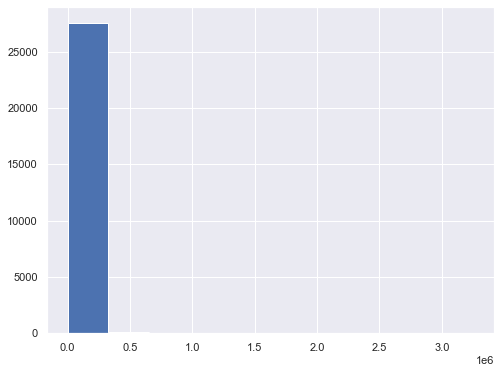

In [64]:
model_data['sqft_lot'].hist();

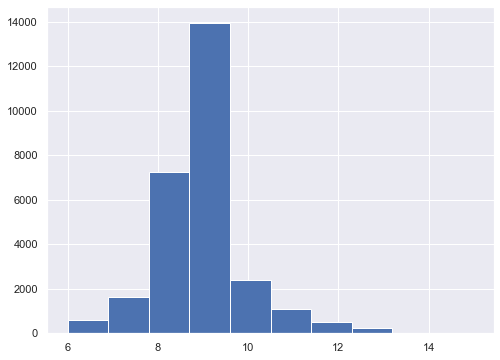

In [65]:
np.log(model_data['sqft_lot']).hist();

In [66]:
model_data['sqft_lot'] = np.log(model_data['sqft_lot'])

In [67]:
X = model_data.drop(columns=['price'])
model_unscaled1 = sm.OLS(y, sm.add_constant(X))
model_unscaled1.fit().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.817
Model:                            OLS   Adj. R-squared:                  0.816
Method:                 Least Squares   F-statistic:                     962.0
Date:                Fri, 31 Mar 2023   Prob (F-statistic):               0.00
Time:                        12:15:20   Log-Likelihood:                 5182.9
No. Observations:               27698   AIC:                        -1.011e+04
Df Residuals:                   27569   BIC:                            -9046.
Df Model:                         128                                         
Covariance Type:            nonrobust                                         
============================================================================================
                               coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                     -265.3938      5.119    -51.844      0.000    -275.428    -255.360
date                         0.1371      0.003     54.150      0.000       0.132       0.142
bedrooms                     0.0067      0.002      3.718      0.000       0.003       0.010
bathrooms                    0.0332      0.002     13.426      0.000       0.028       0.038
sqft_living                  0.0001   3.83e-06     28.251      0.000       0.000       0.000
sqft_lot                     0.0929      0.002     45.145      0.000       0.089       0.097
waterfront                   0.1365      0.012     10.962      0.000       0.112       0.161
nuisance                    -0.0460      0.003    -13.696      0.000      -0.053      -0.039
sqft_above                8.043e-05   3.53e-06     22.813      0.000    7.35e-05    8.73e-05
sqft_garage               2.911e-05   6.18e-06      4.707      0.000     1.7e-05    4.12e-05
sqft_patio                1.176e-05   5.88e-06      2.002      0.045    2.45e-07    2.33e-05
yr_renovated              3.526e-05   3.04e-06     11.615      0.000    2.93e-05    4.12e-05
Auburn                       0.0807      0.031      2.581      0.010       0.019       0.142
Bellevue                     0.3609      0.034     10.489      0.000       0.293       0.428
Federal Way                  0.1042      0.032      3.301      0.001       0.042       0.166
Fife                         0.0980      0.039      2.521      0.012       0.022       0.174
Highline                     0.1188      0.032      3.656      0.000       0.055       0.182
Issaquah                     0.2783      0.031      8.953      0.000       0.217       0.339
Kent                         0.1825      0.026      7.145      0.000       0.132       0.233
Lake Washington              0.2499      0.044      5.730      0.000       0.164       0.335
Mercer Island                0.5019      0.015     34.328      0.000       0.473       0.531
Northshore                   0.1451      0.046      3.144      0.002       0.055       0.236
Renton                       0.1842      0.028      6.620      0.000       0.130       0.239
Riverview                    0.0628      0.048      1.298      0.194      -0.032       0.158
Seattle                      0.2625      0.032      8.144      0.000       0.199       0.326
Shoreline                    0.1905      0.035      5.483      0.000       0.122       0.259
Snoqualmie Valley            0.0996      0.045      2.212      0.027       0.011       0.188
Tahoma                       0.1837      0.024      7.810      0.000       0.138       0.230
Tukwila                      0.1403      0.037      3.810      0.000       0.068       0.213
Vashon Island                0.2109      0.015     13.727      0.000       0.181       0.241
heat_Electrici

In [68]:
X_num = model_data[['bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot', 'sqft_above', 'sqft_garage', 'sqft_patio', 'yr_renovated']]
X_bin = model_data.drop(columns=X_num.columns)
X_num_orig = X_num

In [69]:
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_num)
X_new = pd.DataFrame(data=X_scaled, columns=X_num_orig.columns, index=X_num_orig.index).join(X_bin)

In [80]:
X = X_new.drop(columns=['price', 'bedrooms'])
model_scaled = sm.OLS(y, sm.add_constant(X)).fit()
model_scaled.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.817
Model:                            OLS   Adj. R-squared:                  0.816
Method:                 Least Squares   F-statistic:                     969.0
Date:                Fri, 31 Mar 2023   Prob (F-statistic):               0.00
Time:                        12:15:53   Log-Likelihood:                 5175.9
No. Observations:               27698   AIC:                        -1.010e+04
Df Residuals:                   27570   BIC:                            -9043.
Df Model:                         127                                         
Covariance Type:            nonrobust                                         
============================================================================================
                               coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                     -263.9980      5.120    -51.560      0.000    -274.034    -253.962
bathrooms                    0.0293      0.002     14.574      0.000       0.025       0.033
sqft_living                  0.0976      0.003     30.931      0.000       0.091       0.104
sqft_lot                     0.0906      0.002     45.306      0.000       0.087       0.094
sqft_above                   0.0644      0.003     22.872      0.000       0.059       0.070
sqft_garage                  0.0077      0.002      4.511      0.000       0.004       0.011
sqft_patio                   0.0025      0.001      1.792      0.073      -0.000       0.005
yr_renovated                 0.0145      0.001     11.561      0.000       0.012       0.017
date                         0.1371      0.003     54.122      0.000       0.132       0.142
waterfront                   0.1348      0.012     10.830      0.000       0.110       0.159
nuisance                    -0.0460      0.003    -13.687      0.000      -0.053      -0.039
Auburn                       0.0846      0.031      2.706      0.007       0.023       0.146
Bellevue                     0.3633      0.034     10.559      0.000       0.296       0.431
Federal Way                  0.1080      0.032      3.420      0.001       0.046       0.170
Fife                         0.1015      0.039      2.610      0.009       0.025       0.178
Highline                     0.1221      0.032      3.757      0.000       0.058       0.186
Issaquah                     0.2803      0.031      9.017      0.000       0.219       0.341
Kent                         0.1848      0.026      7.235      0.000       0.135       0.235
Lake Washington              0.2506      0.044      5.745      0.000       0.165       0.336
Mercer Island                0.5030      0.015     34.402      0.000       0.474       0.532
Northshore                   0.1457      0.046      3.157      0.002       0.055       0.236
Renton                       0.1864      0.028      6.699      0.000       0.132       0.241
Riverview                    0.0630      0.048      1.303      0.193      -0.032       0.158
Seattle                      0.2652      0.032      8.228      0.000       0.202       0.328
Shoreline                    0.1947      0.035      5.605      0.000       0.127       0.263
Snoqualmie Valley            0.1003      0.045      2.228      0.026       0.012       0.189
Tahoma                       0.1848      0.024      7.853      0.000       0.139       0.231
Tukwila                      0.1432      0.037      3.889      0.000       0.071       0.215
Vashon Island                0.2112      0.015     13.743      0.000       0.181       0.241
heat_Electricity            -0.0329      0.003     -9.911      0.000      -0.039      -0.026
heat_Electrici

In [71]:
dist_coef = [.5154, .3315, .2526, .225, .2204, .1856, .1723, .1628, .1333, .13, .1097, .0954, .0751, .0714, .0677, .0662, .0532, .0250]
dists =     ['Mercer Island', 'Bellevue', 'Issaquah', 'Lake Washington', 'Seattle', 'Vashon Island', 'Shoreline', 'Kent',
             'Renton', 'Tahoma', 'Federal Way', 'Fife', 'Highline', 'Northshore', 'Tukwila', 'Snoqualmie Valley', 'Auburn', 'Riverview']

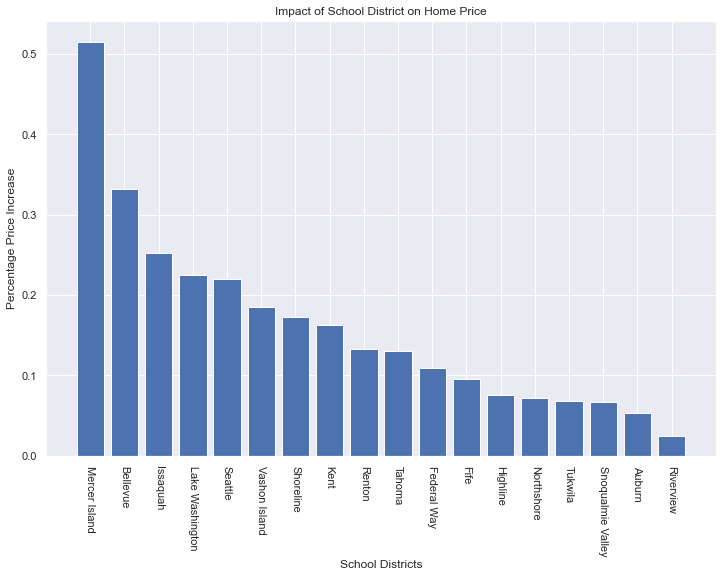

In [72]:
fig, ax = plt.subplots(figsize=(12,8))
plt.xticks(rotation=-90)
ax.set_title('Impact of School District on Home Price')
ax.set_xlabel('School Districts')
ax.set_ylabel('Percentage Price Increase')
ax.bar(dists, dist_coef)
plt.savefig('data/DistrictVsPrice.png', dpi=1000);

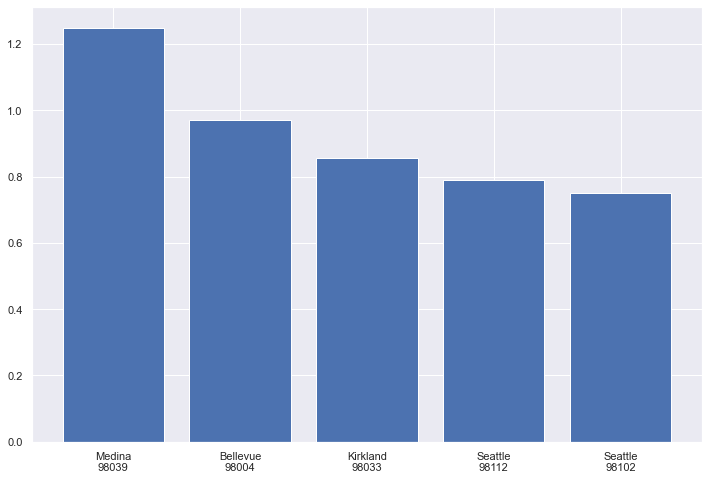

In [73]:
fig, ax = plt.subplots(figsize=(12,8))
height = [1.2497, 0.9697, 0.8562, 0.7906, 0.7519]
x = ['Medina\n98039', 'Bellevue\n98004', 'Kirkland\n98033', 'Seattle\n98112', 'Seattle\n98102']
ax.bar(x, height);

In [74]:
y_pred = model_scaled.predict(sm.add_constant(X))

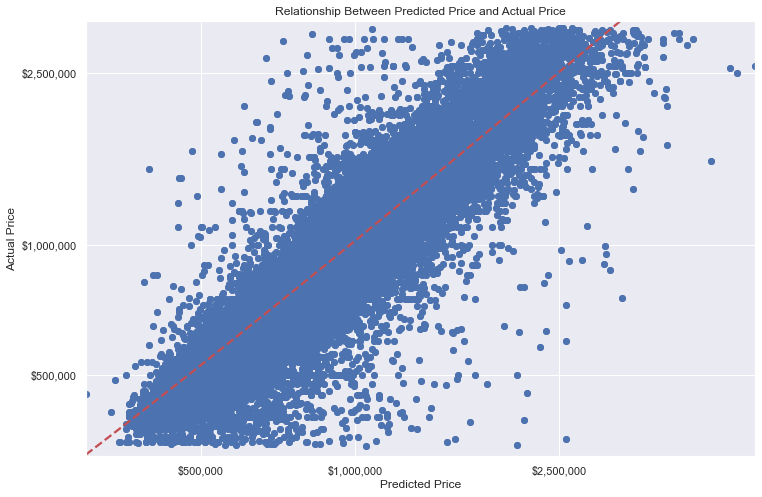

In [95]:
fig, ax = plt.subplots(figsize=(12,8))
plt.scatter(x=np.exp(y_pred), y=np.exp(y))
sns.regplot(x=np.exp(y_pred), y=np.exp(y), line_kws={'ls':'--', 'color': 'r'}, ci = None)
plt.yscale('log')
plt.xscale('log')
plt.ylim((325000, 3300000))
ax.set_xticks([500000, 1000000, 2500000])
ax.set_xticklabels(['$500,000', '$1,000,000', '$2,500,000'])
ax.set_yticks([500000, 1000000, 2500000])
ax.set_yticklabels(['$500,000', '$1,000,000', '$2,500,000'])
ax.set_xlabel('Predicted Price')
ax.set_ylabel('Actual Price')
ax.set_title('Relationship Between Predicted Price and Actual Price')
plt.savefig('data/PredictedVsActual.png', dpi=1000);

In [91]:
np.exp(y.max())

3175000.0

In [90]:
np.exp(y.min())

342500.0

In [76]:
data_resids = y - y_pred

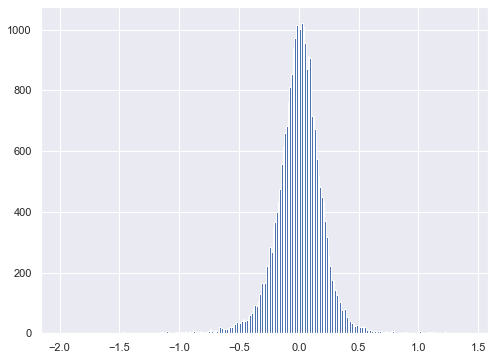

In [77]:
data_resids.hist(bins='auto');

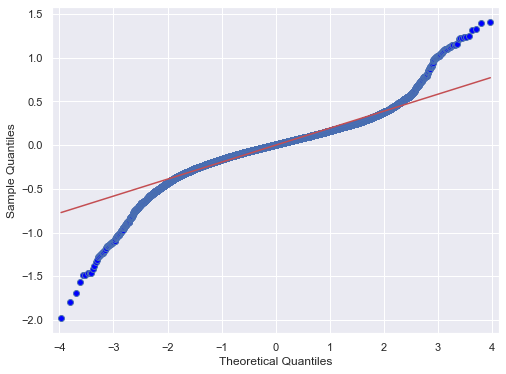

In [78]:
sm.qqplot(data_resids, line='r');